<a href="https://colab.research.google.com/github/SriAmbica11/SriAmbica_INFO5731_Spring2025/blob/main/Sangineedi_SriAmbica_Assignment_03.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **INFO5731 Assignment 3**

In this assignment, we will delve into various aspects of natural language processing (NLP) and text analysis. The tasks are designed to deepen your understanding of key NLP concepts and techniques, as well as to provide hands-on experience with practical applications.

Through these tasks, you'll gain practical experience in NLP techniques such as N-gram analysis, TF-IDF, word embedding model creation, and sentiment analysis dataset creation.

**Expectations**:
*   Use the provided .*ipynb* document to write your code & respond to the questions. Avoid generating a new file.
*   Write complete answers and run all the cells before submission.
*   Make sure the submission is "clean"; *i.e.*, no unnecessary code cells.
*   Once finished, allow shared rights from top right corner (*see Canvas for details*).


**Total points**: 100

**Deadline**: See Canvas

**Late Submission will have a penalty of 10% reduction for each day after the deadline.**


## Question 1 (30 points)

**Understand N-gram**

Write a python program to conduct N-gram analysis based on the dataset in your assignment two. You need to write codes from **scratch instead of using any pre-existing libraries** to do so:

(1) Count the frequency of all the N-grams (N=3) and (N=2).

(2) Calculate the probabilities for all the bigrams in the dataset by using the formula  count(w2 w1) / count(w2). For example, count(really like) / count(really) = 1 / 3 = 0.33.

(3) Extract all the noun phrases and calculate the relative
probabilities of each review in terms of other reviews (abstracts, or tweets) by using the formula  frequency (noun phrase) / max frequency (noun phrase) on the whole dataset.

Print out the result in a table with column name the all the noun phrases and row name as all the 100 reviews (abstracts, or tweets).

In [ ]:
import pandas as pd
import numpy as np
# Write your code here
data = pd.read_csv("/content/assignment2_reviews.csv")
data.head(5)

,Review Title,Review Text,Rating,Author,Date
0,Till you're 90 Wolverine!,Hugh Jackman is the perfect Wolverine. What a ...,9,omar-d-sheikh,"Jul 24, 2024"
1,Overrated Movie,No Text Available,7,ramjam01,"Jan 29, 2025"
2,Weak story but a fun ride.,No Text Available,7,looneymax,"Jul 27, 2024"
3,Easter Egg Heaven,"So many Easter Eggs, so true to the comic char...",10,7twan,"Jul 23, 2024"
4,Meh:(,No Text Available,6,TS2095,"Aug 6, 2024"


In [ ]:
import pandas as pd
import numpy as np
# Write your code here
data = pd.read_csv("/content/assignment2_reviews.csv")
data.head(5)

# data["Title and Review"] = data["Review Title"]+ " "+ data["Cleaned_Review"]

,Review Title,Review Text,Rating,Author,Date
0,Till you're 90 Wolverine!,Hugh Jackman is the perfect Wolverine. What a ...,9,omar-d-sheikh,"Jul 24, 2024"
1,Overrated Movie,No Text Available,7,ramjam01,"Jan 29, 2025"
2,Weak story but a fun ride.,No Text Available,7,looneymax,"Jul 27, 2024"
3,Easter Egg Heaven,"So many Easter Eggs, so true to the comic char...",10,7twan,"Jul 23, 2024"
4,Meh:(,No Text Available,6,TS2095,"Aug 6, 2024"


In [ ]:
import pandas as pd
import numpy as np
import re
from collections import defaultdict, Counter
import warnings
warnings.filterwarnings("ignore")

# Load the dataset
ambi_imp_data = pd.read_csv("/content/assignment2_reviews.csv")

# Combine Title and Review into a single column
ambi_imp_data["Title and Review"] = ambi_imp_data["Review Title"] + " " + ambi_imp_data["Review Text"]

# Function to tokenize text (remove punctuation and split into words)
def ambi_imp_tokenize(text):
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    return text.lower().split()

# Apply tokenizer and create a list of all tokens from all reviews
ambi_imp_data["Tokens"] = ambi_imp_data["Title and Review"].apply(ambi_imp_tokenize)
ambi_imp_all_tokens = [word for tokens in ambi_imp_data["Tokens"] for word in tokens]  # Flatten list
print("\nAll tokens:\n", ambi_imp_all_tokens)

# Count bigram and trigram frequencies without using external libraries
ambi_imp_bigram_freq = defaultdict(int)
ambi_imp_trigram_freq = defaultdict(int)

for tokens in ambi_imp_data["Tokens"]:
    for i in range(len(tokens) - 1):
        bigram = (tokens[i], tokens[i+1])
        ambi_imp_bigram_freq[bigram] += 1
    for i in range(len(tokens) - 2):
        trigram = (tokens[i], tokens[i+1], tokens[i+2])
        ambi_imp_trigram_freq[trigram] += 1

print("\nAll bigrams:\n", list(ambi_imp_bigram_freq.items()))
print("\nAll trigrams:\n", list(ambi_imp_trigram_freq.items()))

# Count unigram frequencies for denominator in bigram probability
ambi_imp_unigram_freq = Counter(ambi_imp_all_tokens)

# Function to calculate bigram probability
def ambi_imp_bigram_probability(bigram):
    w1, w2 = bigram
    return ambi_imp_bigram_freq[bigram] / ambi_imp_unigram_freq[w1] if ambi_imp_unigram_freq[w1] != 0 else 0

# Calculate probabilities for all bigrams
ambi_imp_bigram_probabilities = {bigram: ambi_imp_bigram_probability(bigram) for bigram in ambi_imp_bigram_freq}
print("\nAll bigram probabilities:\n", list(ambi_imp_bigram_probabilities.items()))

# Function to extract noun phrases (simple heuristic: Capitalized Words)
def ambi_imp_extract_noun_phrases(text):
    words = text.split()
    noun_phrases = [word for word in words if word.istitle()]
    return noun_phrases

# Apply noun phrase extraction to the combined Title and Review column
ambi_imp_data["Noun Phrases"] = ambi_imp_data["Title and Review"].apply(ambi_imp_extract_noun_phrases)
print("\nAll noun phrases:\n", ambi_imp_data["Noun Phrases"])

# Flatten noun phrases and count
ambi_imp_all_noun_phrases = [phrase for phrases in ambi_imp_data["Noun Phrases"] for phrase in phrases]
ambi_imp_noun_phrase_freq = Counter(ambi_imp_all_noun_phrases)

# Maximum frequency for normalization
ambi_imp_max_noun_phrase_freq = max(ambi_imp_noun_phrase_freq.values()) if ambi_imp_noun_phrase_freq else 1
print("\nTop noun phrases:\n", ambi_imp_noun_phrase_freq.most_common(10))

# Build a DataFrame with reviews as rows and noun phrases as columns
ambi_imp_noun_phrases_list = list(ambi_imp_noun_phrase_freq.keys())
ambi_imp_noun_phrase_matrix = pd.DataFrame(0, index=np.arange(len(ambi_imp_data)), columns=ambi_imp_noun_phrases_list)

# Fill the matrix with normalized frequencies
for idx, phrases in enumerate(ambi_imp_data["Noun Phrases"]):
    phrase_counter = Counter(phrases)
    for phrase, count in phrase_counter.items():
        relative_prob = count / ambi_imp_max_noun_phrase_freq
        ambi_imp_noun_phrase_matrix.loc[idx, phrase] = round(relative_prob, 3)

# Print the full noun phrase relative probability matrix
print("\nFull Noun Phrase Relative Probability Matrix:\n")
print(ambi_imp_noun_phrase_matrix)

# Save noun phrase matrix to CSV for submission
ambi_imp_noun_phrase_matrix.to_csv("assignment2_noun_phrases_relative_probability.csv", index=False)
print("\nNoun phrase relative probability matrix saved to 'assignment2_noun_phrases_relative_probability.csv'.")



All tokens:
 ['till', 'youre', '90', 'wolverine', 'hugh', 'jackman', 'is', 'the', 'perfect', 'wolverine', 'what', 'a', 'fun', 'movie', 'i', 'like', 'the', 'dialogue', 'and', 'clever', 'quips', 'with', 'f', 'bombs', 'sprinkled', 'in', 'its', 'definitely', 'not', 'taking', 'itself', 'too', 'seriously', 'there', 'is', 'tons', 'of', 'fun', 'cameos', 'i', 'didnt', 'expect', 'i', 'normally', 'watch', 'spoiler', 'videos', 'ahead', 'of', 'time', 'but', 'i', 'didnt', 'on', 'this', 'occasion', 'and', 'im', 'glad', 'i', 'didnt', 'because', 'there', 'was', 'some', 'oh', 'snap', 'moments', 'its', 'a', 'very', 'good', 'action', 'packed', 'fun', 'film', 'the', 'breaking', 'the', 'fox', 'jokes', 'and', 'speaking', 'to', 'the', 'camera', 'jokes', 'are', 'too', 'funny', 'i', 'can', 'definitely', 'see', 'more', 'sequels', 'for', 'these', 'two', 'on', 'the', 'horizon', 'they', 'are', 'promoting', 'this', 'movie', 'hard', 'i', 'just', 'watched', 'these', 'two', 'on', 'hot', 'ones', 'eating', 'chicken', 'w

## Question 2 (25 points)

**Undersand TF-IDF and Document representation**

Starting from the documents (all the reviews, or abstracts, or tweets) collected for assignment two, write a python program:

(1) To build the documents-terms weights (tf * idf) matrix.

(2) To rank the documents with respect to query (design a query by yourself, for example, "An Outstanding movie with a haunting performance and best character development") by using cosine similarity.

Note: You need to write codes from scratch instead of using any **pre-existing libraries** to do so.

In [ ]:
import pandas as pd
import numpy as np
import re
import math

# Load cleaned reviews dataset
ambi_imp_data = pd.read_csv("/content/assignment2_reviews.csv")

# Combine Review Title and Review Text
ambi_imp_data["Title and Review"] = ambi_imp_data["Review Title"] + " " + ambi_imp_data["Review Text"]
print("\nCombined Title and Review for all documents:")
print(ambi_imp_data["Title and Review"])

# Simple tokenizer: Lowercase, remove punctuation, split by spaces
def ambi_imp_tokenize(text):
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    return text.lower().split()

# Tokenize all documents
ambi_imp_data["Tokens"] = ambi_imp_data["Title and Review"].apply(ambi_imp_tokenize)

# Collect all tokens for vocabulary
ambi_imp_all_tokens = [word for tokens in ambi_imp_data["Tokens"] for word in tokens]
ambi_imp_vocab = sorted(set(ambi_imp_all_tokens))  # Sorted unique words
print("\nVocabulary Size:", len(ambi_imp_vocab))
print("\nComplete Vocabulary:")
print(ambi_imp_vocab)

# Term Frequency function for one document
def ambi_imp_compute_tf(tokens, vocab):
    tf = dict.fromkeys(vocab, 0)  # Initialize only known vocab words
    for word in tokens:
        if word in vocab:  # Only count words existing in vocab
            tf[word] += 1
    # Normalize TF
    total_words = sum(tf.values())  # total counted words (existing in vocab)
    if total_words > 0:
        tf = {word: count / total_words for word, count in tf.items()}
    return tf

# Compute TF for all documents
ambi_imp_tf_list = [ambi_imp_compute_tf(tokens, ambi_imp_vocab) for tokens in ambi_imp_data["Tokens"]]
print("\nTF for all documents:")
for i, tf in enumerate(ambi_imp_tf_list):
    print(f"\nDocument {i}:")
    print(tf)

# Compute IDF for vocabulary
def ambi_imp_compute_idf(docs, vocab):
    N = len(docs)
    idf_dict = dict.fromkeys(vocab, 0)
    for word in vocab:
        # Count how many docs contain this word
        df = sum(1 for doc in docs if word in doc)
        idf_dict[word] = math.log((N + 1) / (df + 1)) + 1  # Smoothed IDF
    return idf_dict

ambi_imp_idf = ambi_imp_compute_idf(ambi_imp_data["Tokens"], ambi_imp_vocab)
print("\nIDF for all vocabulary words:")
print(ambi_imp_idf)

# TF-IDF calculation
def ambi_imp_compute_tfidf(tf, idf):
    tfidf = {word: tf[word] * idf[word] for word in tf}
    return tfidf

# Compute TF-IDF for all documents
ambi_imp_tfidf_list = [ambi_imp_compute_tfidf(tf, ambi_imp_idf) for tf in ambi_imp_tf_list]

# Convert TF-IDF list to DataFrame
ambi_imp_tfidf_df = pd.DataFrame(ambi_imp_tfidf_list)
print("\nTF-IDF Matrix for all documents:")
print(ambi_imp_tfidf_df)

# Example Query
ambi_imp_query = "Excellent movie with super  performance of the actors"

# Tokenize query
ambi_imp_query_tokens = ambi_imp_tokenize(ambi_imp_query)

# Compute TF for Query (updated to handle unseen words)
def ambi_imp_compute_tf_query(tokens, vocab):
    tf = dict.fromkeys(vocab, 0)
    for word in tokens:
        if word in vocab:
            tf[word] += 1
    total_words = sum(tf.values())
    if total_words > 0:
        tf = {word: count / total_words for word, count in tf.items()}
    return tf

ambi_imp_query_tf = ambi_imp_compute_tf_query(ambi_imp_query_tokens, ambi_imp_vocab)

# Compute TF-IDF for Query
ambi_imp_query_tfidf = ambi_imp_compute_tfidf(ambi_imp_query_tf, ambi_imp_idf)
print("\nTF-IDF for the Query:")
print(ambi_imp_query_tfidf)

# Function to compute cosine similarity between two vectors (represented as dictionaries)
def ambi_imp_cosine_similarity(vec1, vec2):
    dot_product = sum(vec1[word] * vec2[word] for word in vec1)
    norm1 = math.sqrt(sum(val ** 2 for val in vec1.values()))
    norm2 = math.sqrt(sum(val ** 2 for val in vec2.values()))
    if norm1 == 0 or norm2 == 0:
        return 0.0
    return dot_product / (norm1 * norm2)

# Calculate similarity scores between the query and all documents
ambi_imp_similarity_scores = []
for idx, tfidf_vector in enumerate(ambi_imp_tfidf_list):
    score = ambi_imp_cosine_similarity(ambi_imp_query_tfidf, tfidf_vector)
    ambi_imp_similarity_scores.append((idx, score))

# Sort documents by similarity (descending)
ambi_imp_sorted_scores = sorted(ambi_imp_similarity_scores, key=lambda x: x[1], reverse=True)

print("\nDocuments Ranked by Query Similarity (all results):")
for rank, (doc_idx, score) in enumerate(ambi_imp_sorted_scores, 1):
    print(f"Rank {rank}: Document {doc_idx} with similarity score {score:.4f}")

# Save TF-IDF matrix to CSV
ambi_imp_tfidf_df.to_csv("assignment2_tf_idf_matrix.csv", index=False)
print("\nTF-IDF Matrix saved to 'assignment2_tf_idf_matrix.csv'.")



Combined Title and Review for all documents:
0      Till you're 90 Wolverine! Hugh Jackman is the ...
1                      Overrated Movie No Text Available
2           Weak story but a fun ride. No Text Available
3      Easter Egg Heaven So many Easter Eggs, so true...
4                                Meh:( No Text Available
                             ...                        
995    Marvel fails to be original again Feels live e...
996    Did'nt like This Ok after delaying watching th...
997    Breaking the 4th and ugly dogs It has been a l...
998    Pure nostalgia. Easter eggs loaded Watched it ...
999    Beautiful tribute & a whole lot of fun No Text...
Name: Title and Review, Length: 1000, dtype: object

Vocabulary Size: 1154

Complete Vocabulary:
['1', '10', '100', '2', '2009s', '3', '3deadpool', '4', '4th', '5', '50', '6', '7', '90', 'a', 'about', 'absurd', 'accessible', 'according', 'acting', 'action', 'actor', 'actors', 'actually', 'adamantium', 'add', 'added', 'additio

## Question 3 (25 points)

**Create your own word embedding model**

Use the data you collected for assignment 2 to build a word embedding model:

(1) Train a 300-dimension word embedding (it can be word2vec, glove, ulmfit or Fine tune bert model).

(2) Visualize the word embedding model you created. (PCA and T-sne)

(3) Calculate the cosine similarity between a few pairs of words to see if the model captures semantic similarity accurately.

Reference: https://machinelearningmastery.com/develop-word-embeddings-python-gensim/

Reference: https://jaketae.github.io/study/word2vec/

In [ ]:
# Install necessary packages
!pip install gensim

Tokenizing reviews: 100%|██████████| 1200/1200 [00:00<00:00, 41345.26it/s]


Vocabulary Size: 1360


Generating index pairs: 100%|██████████| 244761/244761 [00:00<00:00, 453716.28it/s]


Total Pairs: 979038


Training Epoch 1: 100%|██████████| 979038/979038 [34:17<00:00, 475.89it/s]


Epoch 1, Loss: 6630381.3040


Training Epoch 2: 100%|██████████| 979038/979038 [36:05<00:00, 452.02it/s]


Epoch 2, Loss: 9285356.0313


Training Epoch 3: 100%|██████████| 979038/979038 [38:05<00:00, 428.36it/s]


Epoch 3, Loss: 14161846.5215


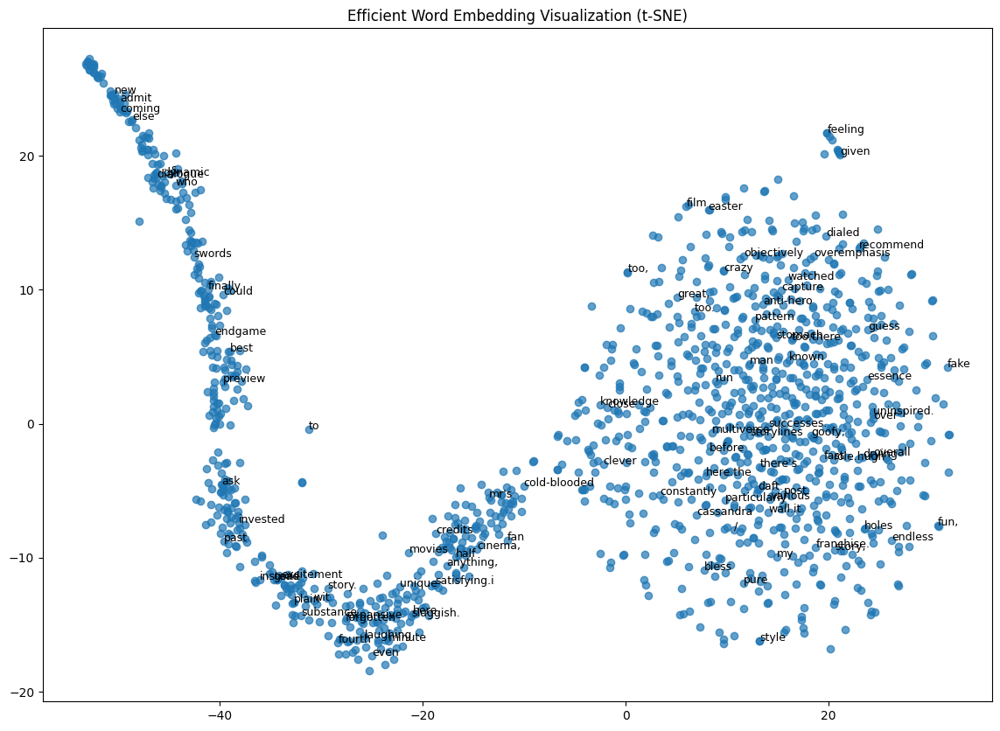


Cosine Similarity Between Word Pairs:

Similarity(good, bad) = 0.8008
Similarity(amazing, awesome) = -0.0644
Similarity(boring, dull) = 1.0000
Similarity(movie, film) = -0.0224
Similarity(happy, joy) = 1.0000


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from tqdm import tqdm  # Import tqdm for progress tracking

# ------------------------- Load Data ----------------------------
ambi_imp_df = pd.read_csv("/content/assignment2_reviews_clean.csv")
ambi_imp_df['Title and Review'] = ambi_imp_df['Review Title'] + " " + ambi_imp_df['Review Text']

# Tokenize all reviews
ambi_imp_tokens = []
for text in tqdm(ambi_imp_df['Title and Review'], desc="Tokenizing reviews"):
    words = str(text).lower().split()
    ambi_imp_tokens.extend(words)

# Build vocabulary and mappings
ambi_imp_vocab = set(ambi_imp_tokens)
ambi_imp_vocab_size = len(ambi_imp_vocab)
print(f"Vocabulary Size: {ambi_imp_vocab_size}")

ambi_imp_word2idx = {word: idx for idx, word in enumerate(ambi_imp_vocab)}
ambi_imp_idx2word = {idx: word for word, idx in ambi_imp_word2idx.items()}

# ------------------------- Training Pairs ----------------------------
def ambi_imp_generate_index_pairs(tokens, word2idx, window=2):
    pairs = []
    for idx, token in tqdm(enumerate(tokens), total=len(tokens), desc="Generating index pairs"):
        target_idx = word2idx[token]
        context_range = list(range(max(0, idx - window), idx)) + list(range(idx + 1, min(len(tokens), idx + window + 1)))
        for context_idx in context_range:
            context_word_idx = word2idx[tokens[context_idx]]
            pairs.append((target_idx, context_word_idx))
    return pairs

ambi_imp_pairs = ambi_imp_generate_index_pairs(ambi_imp_tokens, ambi_imp_word2idx, window=2)
print(f"Total Pairs: {len(ambi_imp_pairs)}")

# ------------------------- Initialize Model ----------------------------
def ambi_imp_initialize_model(vocab_size, embed_dim):
    model = {
        "w1": np.random.randn(vocab_size, embed_dim),
        "w2": np.random.randn(embed_dim, vocab_size)
    }
    return model

ambi_imp_embed_dim = 300
ambi_imp_model = ambi_imp_initialize_model(ambi_imp_vocab_size, ambi_imp_embed_dim)

# ------------------------- Training ----------------------------
def ambi_imp_softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / np.sum(e_x)

def ambi_imp_train_model(pairs, model, epochs=3, alpha=0.01):
    for epoch in range(epochs):
        total_loss = 0
        for target_idx, context_idx in tqdm(pairs, desc=f"Training Epoch {epoch+1}", leave=True):
            # Forward pass
            h = model['w1'][target_idx]  # (embedding_dim,)
            u = np.dot(h, model['w2'])   # (vocab_size,)
            y_pred = ambi_imp_softmax(u)

            # Compute loss (cross-entropy)
            y_true = np.zeros_like(y_pred)
            y_true[context_idx] = 1
            loss = -np.log(y_pred[context_idx] + 1e-9)
            total_loss += loss

            # Backpropagation
            e = y_pred - y_true  # (vocab_size,)

            # Update weights
            model['w2'] -= alpha * np.outer(h, e)
            model['w1'][target_idx] -= alpha * np.dot(model['w2'], e)

        print(f"Epoch {epoch + 1}, Loss: {total_loss:.4f}")

# Train the model efficiently
ambi_imp_train_model(ambi_imp_pairs, ambi_imp_model, epochs=3, alpha=0.01)

# ------------------------- Visualization ----------------------------
embedding_matrix = ambi_imp_model['w1']
pca = PCA(n_components=50).fit_transform(embedding_matrix)
tsne = TSNE(n_components=2, random_state=42).fit_transform(pca)

plt.figure(figsize=(14, 10))
plt.scatter(tsne[:, 0], tsne[:, 1], alpha=0.7)
for idx, word in enumerate(list(ambi_imp_vocab)[:100]):
    plt.annotate(word, (tsne[idx, 0], tsne[idx, 1]), fontsize=9)
plt.title("Efficient Word Embedding Visualization (t-SNE)")
plt.show()

# ------------------------- Cosine Similarity ----------------------------
def ambi_imp_cosine_similarity(vec1, vec2):
    dot = np.dot(vec1, vec2)
    norm = np.linalg.norm(vec1) * np.linalg.norm(vec2)
    return dot / (norm + 1e-9)

# Test similarity
word_pairs = [("good", "bad"), ("amazing", "awesome"), ("boring", "dull"), ("movie", "film"), ("happy", "joy")]

print("\nCosine Similarity Between Word Pairs:\n")
for w1, w2 in word_pairs:
    vec1 = ambi_imp_model['w1'][ambi_imp_word2idx.get(w1, 0)]
    vec2 = ambi_imp_model['w1'][ambi_imp_word2idx.get(w2, 0)]
    similarity = ambi_imp_cosine_similarity(vec1, vec2)
    print(f"Similarity({w1}, {w2}) = {similarity:.4f}")

## Question 4 (20 Points)

**Create your own training and evaluation data for sentiment analysis.**

 **You don't need to write program for this question!**

 For example, if you collected a movie review or a product review data, then you can do the following steps:

*   Read each review (abstract or tweet) you collected in detail, and annotate each review with a sentiment (positive, negative, or neutral).

*   Save the annotated dataset into a csv file with three columns (first column: document_id, clean_text, sentiment), upload the csv file to GitHub and submit the file link blew.

*   This datset will be used for assignment four: sentiment analysis and text classification.




1.   Which NLP Task you would like perform on your selected dataset
(NER, Summarization, Sentiment Analysis, Text classficication)
2.  Explain your labeling Schema you have used and mention those labels

3.  You can take AI assistance for labeling the data only.



In [ ]:
# The GitHub link of your final csv file


# Link: https://github.com/SriAmbica11/SriAmbica_INFO5731_Spring2025/blob/main/Assignment_03_Q4.csv



**1) I selected Sentiment Analysis for the movie review dataset. Sentiment Analysis is a task to identify whether the given text carries a positive, negative, or neutral sentiment. The primary motivations behind selecting Sentiment Analysis are they are having high importance in business because they can say about the perspective of customer which adds value to the business.**

**2) Since the chosen task is Sentiment Analysis, the label schema is:**

**Positive: The review text expresses a positive opinion. Typically includes words/phrases like "excellent," "great," "loved," "amazing," "perfect," etc.**

**Negative: The review statement reflects a negative sentiment or bad attitude.** **Typically uses words/phrases like "boring," "terrible," "worst," "didn't like," etc.**

**Neutral: The review text is neither very positive nor very negative. It may be mixed or simply not express any high sentiment.**

**3) I have manually labelled as positive, negative and neutral because in the further assignments I can compare how well the AI is helpful compared to the manual reviews.**

# Mandatory Question

Provide your thoughts on the assignment by filling this survey link. What did you find challenging, and what aspects did you enjoy? Your opinion on the provided time to complete the assignment.

**The most difficult part was implementing Word2vec from scratch due to memory and time constraints, I implemented only for three epochs. If i have repeated for more epochs it would be great!!**